In [1]:
# librerias
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import mysql.connector
import matplotlib as plt
import warnings
import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import LabelEncoder
warnings.filterwarnings('ignore')
from sqlalchemy import create_engine
import seaborn as sns
from datetime import datetime
pd.set_option('display.max_columns', None)

In [2]:
import pandas as pd

# List of Excel file names
files = [
    'divergence_part_1.xlsx',
    'divergence_part_2.xlsx',
    'divergence_part_3.xlsx',
    'divergence_part_4.xlsx',
    'divergence_part_5.xlsx',
    'divergence_part_6.xlsx',
    'divergence_part_7.xlsx',
    'divergence_part_8.xlsx',
    'divergence_part_9.xlsx',
    'divergence_part_10.xlsx',
    'divergence_part_11.xlsx',
    'divergence_part_12.xlsx',
    'divergence_part_13.xlsx'
]
# Read each Excel file into a DataFrame and store in a list
dataframes = [pd.read_excel(file) for file in files]

# Concatenate all DataFrames into a single DataFrame
combined_df = pd.concat(dataframes, ignore_index=True)

In [3]:
print(combined_df.dtypes)
combined_df

id                           int64
ticker                      object
v                            int64
vw                         float64
o                          float64
c                          float64
h                          float64
l                          float64
t                            int64
n                            int64
iv                         float64
delta                      float64
gamma                      float64
theta                      float64
vega                       float64
underlying_price           float64
dte                          int64
type                        object
strike                       int64
stock                       object
date                datetime64[ns]
dtype: object


,id,ticker,v,vw,o,c,h,l,t,n,iv,delta,gamma,theta,vega,underlying_price,dte,type,strike,stock,date
0,1,O:SPY240614P00536000,7,0.1743,0.17,0.17,0.18,0.17,1718371800000,3,0.201933,-0.095560,0.044892,-0.727493,0.031787,540.880,0,PUT,536,SPY,2024-06-14
1,2,O:SPY240614P00536000,2,0.1600,0.16,0.16,0.16,0.16,1718371804000,2,0.198754,-0.092066,0.044375,-0.696624,0.030923,540.880,0,PUT,536,SPY,2024-06-14
2,3,O:SPY240614P00536000,2,0.1600,0.16,0.16,0.16,0.16,1718371806000,1,0.198760,-0.092066,0.044375,-0.696661,0.030922,540.880,0,PUT,536,SPY,2024-06-14
3,4,O:SPY240614P00536000,4,0.1600,0.16,0.16,0.16,0.16,1718371807000,2,0.198762,-0.092066,0.044375,-0.696680,0.030922,540.880,0,PUT,536,SPY,2024-06-14
4,5,O:SPY240614P00536000,100,0.1600,0.16,0.16,0.16,0.16,1718371808000,3,0.198765,-0.092066,0.044375,-0.696698,0.030922,540.880,0,PUT,536,SPY,2024-06-14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1218772,1218773,O:SPY240613C00548000,2,0.0100,0.01,0.01,0.01,0.01,1718306841000,1,0.192614,0.012153,0.013267,-0.199282,0.003902,542.595,0,CALL,548,SPY,2024-06-13
1218773,1218774,O:SPY240613C00548000,9,0.0100,0.01,0.01,0.01,0.01,1718307021000,1,0.196345,0.012006,0.012952,-0.202081,0.003840,542.510,0,CALL,548,SPY,2024-06-13
1218774,1218775,O:SPY240613C00548000,1,0.0100,0.01,0.01,0.01,0.01,1718307022000,1,0.196351,0.012006,0.012952,-0.202093,0.003840,542.510,0,CALL,548,SPY,2024-06-13
1218775,1218776,O:SPY240613C00548000,2,0.0100,0.01,0.01,0.01,0.01,1718307033000,1,0.201728,0.011725,0.012358,-0.203385,0.003759,542.340,0,CALL,548,SPY,2024-06-13


In [4]:
combined_df['time'] = combined_df['t'].apply(lambda x: datetime.fromtimestamp(x / 1000.0).strftime('%H:%M:%S'))
combined_df['d_abs'] = combined_df['delta'].abs()

In [5]:
combined_df

,id,ticker,v,vw,o,c,h,l,t,n,iv,delta,gamma,theta,vega,underlying_price,dte,type,strike,stock,date,time,d_abs
0,1,O:SPY240614P00536000,7,0.1743,0.17,0.17,0.18,0.17,1718371800000,3,0.201933,-0.095560,0.044892,-0.727493,0.031787,540.880,0,PUT,536,SPY,2024-06-14,15:30:00,0.095560
1,2,O:SPY240614P00536000,2,0.1600,0.16,0.16,0.16,0.16,1718371804000,2,0.198754,-0.092066,0.044375,-0.696624,0.030923,540.880,0,PUT,536,SPY,2024-06-14,15:30:04,0.092066
2,3,O:SPY240614P00536000,2,0.1600,0.16,0.16,0.16,0.16,1718371806000,1,0.198760,-0.092066,0.044375,-0.696661,0.030922,540.880,0,PUT,536,SPY,2024-06-14,15:30:06,0.092066
3,4,O:SPY240614P00536000,4,0.1600,0.16,0.16,0.16,0.16,1718371807000,2,0.198762,-0.092066,0.044375,-0.696680,0.030922,540.880,0,PUT,536,SPY,2024-06-14,15:30:07,0.092066
4,5,O:SPY240614P00536000,100,0.1600,0.16,0.16,0.16,0.16,1718371808000,3,0.198765,-0.092066,0.044375,-0.696698,0.030922,540.880,0,PUT,536,SPY,2024-06-14,15:30:08,0.092066
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1218772,1218773,O:SPY240613C00548000,2,0.0100,0.01,0.01,0.01,0.01,1718306841000,1,0.192614,0.012153,0.013267,-0.199282,0.003902,542.595,0,CALL,548,SPY,2024-06-13,21:27:21,0.012153
1218773,1218774,O:SPY240613C00548000,9,0.0100,0.01,0.01,0.01,0.01,1718307021000,1,0.196345,0.012006,0.012952,-0.202081,0.003840,542.510,0,CALL,548,SPY,2024-06-13,21:30:21,0.012006
1218774,1218775,O:SPY240613C00548000,1,0.0100,0.01,0.01,0.01,0.01,1718307022000,1,0.196351,0.012006,0.012952,-0.202093,0.003840,542.510,0,CALL,548,SPY,2024-06-13,21:30:22,0.012006
1218775,1218776,O:SPY240613C00548000,2,0.0100,0.01,0.01,0.01,0.01,1718307033000,1,0.201728,0.011725,0.012358,-0.203385,0.003759,542.340,0,CALL,548,SPY,2024-06-13,21:30:33,0.011725


In [6]:
df = combined_df[combined_df['date'] == '2024-06-14']
df.to_csv('divergence_clean.csv', index=False)  # actualizado a fecha 23 junio a las 18h21h
df = df.sort_values(by='time', ascending=True)
df

,id,ticker,v,vw,o,c,h,l,t,n,iv,delta,gamma,theta,vega,underlying_price,dte,type,strike,stock,date,time,d_abs
0,1,O:SPY240614P00536000,7,0.1743,0.17,0.17,0.18,0.17,1718371800000,3,0.201933,-0.095560,0.044892,-0.727493,0.031787,540.88,0,PUT,536,SPY,2024-06-14,15:30:00,0.095560
23376,23377,O:SPY240614P00540000,386,0.7568,0.74,0.78,0.87,0.74,1718371800000,23,0.152288,-0.374009,0.132861,-1.210910,0.070948,540.88,0,PUT,540,SPY,2024-06-14,15:30:00,0.374009
49625,49626,O:SPY240614P00542000,25,1.7604,1.81,1.75,1.81,1.75,1718371800000,7,0.158432,-0.642439,0.125806,-1.224370,0.069891,540.88,0,PUT,542,SPY,2024-06-14,15:30:00,0.642439
58743,58744,O:SPY240614P00543000,12,2.4717,2.39,2.47,2.51,2.39,1718371800000,4,0.136349,-0.792584,0.112057,-0.784088,0.053575,540.88,0,PUT,543,SPY,2024-06-14,15:30:00,0.792584
63486,63487,O:SPY240614C00538000,16,3.2569,3.49,3.21,3.49,3.21,1718371800000,4,0.220497,0.761132,0.075097,-1.511290,0.058063,540.88,0,CALL,538,SPY,2024-06-14,15:30:00,0.761132
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58742,58743,O:SPY240614P00542000,1,0.3200,0.32,0.32,0.32,0.32,1718392797000,1,0.087057,-0.407994,0.356353,-1.061690,0.048598,542.24,0,PUT,542,SPY,2024-06-14,21:19:57,0.407994
14404,14405,O:SPY240614P00538000,1,0.0200,0.02,0.02,0.02,0.02,1718392798000,1,0.173350,-0.024437,0.026429,-0.318311,0.007176,542.24,0,PUT,538,SPY,2024-06-14,21:19:58,0.024437
70450,70451,O:SPY240614C00540000,1,2.2700,2.27,2.27,2.27,2.27,1718392798000,1,0.099960,0.964483,0.062511,-0.312918,0.009788,542.24,0,CALL,540,SPY,2024-06-14,21:19:58,0.964483
65393,65394,O:SPY240614C00539000,1,3.2900,3.29,3.29,3.29,3.29,1718392798000,1,0.155552,0.953267,0.050188,-0.549624,0.012229,542.24,0,CALL,539,SPY,2024-06-14,21:19:58,0.953267


In [7]:
pd.set_option('display.max_rows', None)
df_delta = df[(df['d_abs'] > 0.09) & (df['d_abs'] < 0.11)]
df_delta = df_delta.reset_index(drop=True)
df_delta

,id,ticker,v,vw,o,c,h,l,t,n,iv,delta,gamma,theta,vega,underlying_price,dte,type,strike,stock,date,time,d_abs
0,1,O:SPY240614P00536000,7,0.1743,0.17,0.17,0.18,0.17,1718371800000,3,0.201933,-0.095560,0.044892,-0.727493,0.031787,540.880,0,PUT,536,SPY,2024-06-14,15:30:00,0.095560
1,2,O:SPY240614P00536000,2,0.1600,0.16,0.16,0.16,0.16,1718371804000,2,0.198754,-0.092066,0.044375,-0.696624,0.030923,540.880,0,PUT,536,SPY,2024-06-14,15:30:04,0.092066
2,3,O:SPY240614P00536000,2,0.1600,0.16,0.16,0.16,0.16,1718371806000,1,0.198760,-0.092066,0.044375,-0.696661,0.030922,540.880,0,PUT,536,SPY,2024-06-14,15:30:06,0.092066
3,4,O:SPY240614P00536000,4,0.1600,0.16,0.16,0.16,0.16,1718371807000,2,0.198762,-0.092066,0.044375,-0.696680,0.030922,540.880,0,PUT,536,SPY,2024-06-14,15:30:07,0.092066
4,5,O:SPY240614P00536000,100,0.1600,0.16,0.16,0.16,0.16,1718371808000,3,0.198765,-0.092066,0.044375,-0.696698,0.030922,540.880,0,PUT,536,SPY,2024-06-14,15:30:08,0.092066
5,6,O:SPY240614P00536000,899,0.1700,0.17,0.17,0.17,0.17,1718371809000,9,0.201957,-0.095560,0.044892,-0.727667,0.031783,540.880,0,PUT,536,SPY,2024-06-14,15:30:09,0.095560
6,7,O:SPY240614P00536000,1,0.1600,0.16,0.16,0.16,0.16,1718371812000,1,0.198775,-0.092066,0.044375,-0.696773,0.030920,540.880,0,PUT,536,SPY,2024-06-14,15:30:12,0.092066
7,8,O:SPY240614P00536000,2,0.1650,0.17,0.16,0.17,0.16,1718371813000,2,0.201967,-0.095560,0.044892,-0.727744,0.031782,540.880,0,PUT,536,SPY,2024-06-14,15:30:13,0.095560
8,9,O:SPY240614P00536000,51,0.1600,0.16,0.16,0.16,0.16,1718371814000,2,0.198780,-0.092066,0.044375,-0.696810,0.030919,540.880,0,PUT,536,SPY,2024-06-14,15:30:14,0.092066
9,10,O:SPY240614P00536000,1,0.1600,0.16,0.16,0.16,0.16,1718371815000,1,0.198783,-0.092066,0.044375,-0.696828,0.030919,540.880,0,PUT,536,SPY,2024-06-14,15:30:15,0.092066


In [8]:
put_mask = df_delta['type'] == 'PUT'
rolling_avg_c = df_delta.loc[put_mask, 'c'].rolling(window=2, min_periods=1).mean()
df_delta.loc[put_mask, 'avg_p'] = rolling_avg_c

put_mask = df_delta['type'] == 'CALL'
rolling_avg_c = df_delta.loc[put_mask, 'c'].rolling(window=2, min_periods=1).mean()
df_delta.loc[put_mask, 'avg_c'] = rolling_avg_c

In [9]:
df_delta

,id,ticker,v,vw,o,c,h,l,t,n,iv,delta,gamma,theta,vega,underlying_price,dte,type,strike,stock,date,time,d_abs,avg_p,avg_c
0,1,O:SPY240614P00536000,7,0.1743,0.17,0.17,0.18,0.17,1718371800000,3,0.201933,-0.095560,0.044892,-0.727493,0.031787,540.880,0,PUT,536,SPY,2024-06-14,15:30:00,0.095560,0.170,NaN
1,2,O:SPY240614P00536000,2,0.1600,0.16,0.16,0.16,0.16,1718371804000,2,0.198754,-0.092066,0.044375,-0.696624,0.030923,540.880,0,PUT,536,SPY,2024-06-14,15:30:04,0.092066,0.165,NaN
2,3,O:SPY240614P00536000,2,0.1600,0.16,0.16,0.16,0.16,1718371806000,1,0.198760,-0.092066,0.044375,-0.696661,0.030922,540.880,0,PUT,536,SPY,2024-06-14,15:30:06,0.092066,0.160,NaN
3,4,O:SPY240614P00536000,4,0.1600,0.16,0.16,0.16,0.16,1718371807000,2,0.198762,-0.092066,0.044375,-0.696680,0.030922,540.880,0,PUT,536,SPY,2024-06-14,15:30:07,0.092066,0.160,NaN
4,5,O:SPY240614P00536000,100,0.1600,0.16,0.16,0.16,0.16,1718371808000,3,0.198765,-0.092066,0.044375,-0.696698,0.030922,540.880,0,PUT,536,SPY,2024-06-14,15:30:08,0.092066,0.160,NaN
5,6,O:SPY240614P00536000,899,0.1700,0.17,0.17,0.17,0.17,1718371809000,9,0.201957,-0.095560,0.044892,-0.727667,0.031783,540.880,0,PUT,536,SPY,2024-06-14,15:30:09,0.095560,0.165,NaN
6,7,O:SPY240614P00536000,1,0.1600,0.16,0.16,0.16,0.16,1718371812000,1,0.198775,-0.092066,0.044375,-0.696773,0.030920,540.880,0,PUT,536,SPY,2024-06-14,15:30:12,0.092066,0.165,NaN
7,8,O:SPY240614P00536000,2,0.1650,0.17,0.16,0.17,0.16,1718371813000,2,0.201967,-0.095560,0.044892,-0.727744,0.031782,540.880,0,PUT,536,SPY,2024-06-14,15:30:13,0.095560,0.160,NaN
8,9,O:SPY240614P00536000,51,0.1600,0.16,0.16,0.16,0.16,1718371814000,2,0.198780,-0.092066,0.044375,-0.696810,0.030919,540.880,0,PUT,536,SPY,2024-06-14,15:30:14,0.092066,0.160,NaN
9,10,O:SPY240614P00536000,1,0.1600,0.16,0.16,0.16,0.16,1718371815000,1,0.198783,-0.092066,0.044375,-0.696828,0.030919,540.880,0,PUT,536,SPY,2024-06-14,15:30:15,0.092066,0.160,NaN


In [10]:
df_delta['avg_p'].fillna(method='ffill', inplace=True)
df_delta['avg_c'].fillna(method='ffill', inplace=True)
df_delta['diff'] = df_delta['avg_p'] - df_delta['avg_c']
df_delta

,id,ticker,v,vw,o,c,h,l,t,n,iv,delta,gamma,theta,vega,underlying_price,dte,type,strike,stock,date,time,d_abs,avg_p,avg_c,diff
0,1,O:SPY240614P00536000,7,0.1743,0.17,0.17,0.18,0.17,1718371800000,3,0.201933,-0.095560,0.044892,-0.727493,0.031787,540.880,0,PUT,536,SPY,2024-06-14,15:30:00,0.095560,0.170,NaN,NaN
1,2,O:SPY240614P00536000,2,0.1600,0.16,0.16,0.16,0.16,1718371804000,2,0.198754,-0.092066,0.044375,-0.696624,0.030923,540.880,0,PUT,536,SPY,2024-06-14,15:30:04,0.092066,0.165,NaN,NaN
2,3,O:SPY240614P00536000,2,0.1600,0.16,0.16,0.16,0.16,1718371806000,1,0.198760,-0.092066,0.044375,-0.696661,0.030922,540.880,0,PUT,536,SPY,2024-06-14,15:30:06,0.092066,0.160,NaN,NaN
3,4,O:SPY240614P00536000,4,0.1600,0.16,0.16,0.16,0.16,1718371807000,2,0.198762,-0.092066,0.044375,-0.696680,0.030922,540.880,0,PUT,536,SPY,2024-06-14,15:30:07,0.092066,0.160,NaN,NaN
4,5,O:SPY240614P00536000,100,0.1600,0.16,0.16,0.16,0.16,1718371808000,3,0.198765,-0.092066,0.044375,-0.696698,0.030922,540.880,0,PUT,536,SPY,2024-06-14,15:30:08,0.092066,0.160,NaN,NaN
5,6,O:SPY240614P00536000,899,0.1700,0.17,0.17,0.17,0.17,1718371809000,9,0.201957,-0.095560,0.044892,-0.727667,0.031783,540.880,0,PUT,536,SPY,2024-06-14,15:30:09,0.095560,0.165,NaN,NaN
6,7,O:SPY240614P00536000,1,0.1600,0.16,0.16,0.16,0.16,1718371812000,1,0.198775,-0.092066,0.044375,-0.696773,0.030920,540.880,0,PUT,536,SPY,2024-06-14,15:30:12,0.092066,0.165,NaN,NaN
7,8,O:SPY240614P00536000,2,0.1650,0.17,0.16,0.17,0.16,1718371813000,2,0.201967,-0.095560,0.044892,-0.727744,0.031782,540.880,0,PUT,536,SPY,2024-06-14,15:30:13,0.095560,0.160,NaN,NaN
8,9,O:SPY240614P00536000,51,0.1600,0.16,0.16,0.16,0.16,1718371814000,2,0.198780,-0.092066,0.044375,-0.696810,0.030919,540.880,0,PUT,536,SPY,2024-06-14,15:30:14,0.092066,0.160,NaN,NaN
9,10,O:SPY240614P00536000,1,0.1600,0.16,0.16,0.16,0.16,1718371815000,1,0.198783,-0.092066,0.044375,-0.696828,0.030919,540.880,0,PUT,536,SPY,2024-06-14,15:30:15,0.092066,0.160,NaN,NaN


In [84]:
df_delta['rolling_mean'] = df_delta['diff'].rolling(window=800).mean()
df_delta['std'] = df_delta['rolling_mean'].rolling(window=50).std()
df_delta['rolling_std'] = df_delta['rolling_mean'] + df_delta['std']
df_delta['rolling_std']= df_delta['rolling_std']*1.5
df_delta

,id,ticker,v,vw,o,c,h,l,t,n,iv,delta,gamma,theta,vega,underlying_price,dte,type,strike,stock,date,time,d_abs,avg_p,avg_c,diff,rolling_mean,rolling_std,std
0,1,O:SPY240614P00536000,7,0.1743,0.17,0.17,0.18,0.17,1718371800000,3,0.201933,-0.095560,0.044892,-0.727493,0.031787,540.880,0,PUT,536,SPY,2024-06-14,15:30:00,0.095560,0.170,NaN,NaN,NaN,NaN,NaN
1,2,O:SPY240614P00536000,2,0.1600,0.16,0.16,0.16,0.16,1718371804000,2,0.198754,-0.092066,0.044375,-0.696624,0.030923,540.880,0,PUT,536,SPY,2024-06-14,15:30:04,0.092066,0.165,NaN,NaN,NaN,NaN,NaN
2,3,O:SPY240614P00536000,2,0.1600,0.16,0.16,0.16,0.16,1718371806000,1,0.198760,-0.092066,0.044375,-0.696661,0.030922,540.880,0,PUT,536,SPY,2024-06-14,15:30:06,0.092066,0.160,NaN,NaN,NaN,NaN,NaN
3,4,O:SPY240614P00536000,4,0.1600,0.16,0.16,0.16,0.16,1718371807000,2,0.198762,-0.092066,0.044375,-0.696680,0.030922,540.880,0,PUT,536,SPY,2024-06-14,15:30:07,0.092066,0.160,NaN,NaN,NaN,NaN,NaN
4,5,O:SPY240614P00536000,100,0.1600,0.16,0.16,0.16,0.16,1718371808000,3,0.198765,-0.092066,0.044375,-0.696698,0.030922,540.880,0,PUT,536,SPY,2024-06-14,15:30:08,0.092066,0.160,NaN,NaN,NaN,NaN,NaN
5,6,O:SPY240614P00536000,899,0.1700,0.17,0.17,0.17,0.17,1718371809000,9,0.201957,-0.095560,0.044892,-0.727667,0.031783,540.880,0,PUT,536,SPY,2024-06-14,15:30:09,0.095560,0.165,NaN,NaN,NaN,NaN,NaN
6,7,O:SPY240614P00536000,1,0.1600,0.16,0.16,0.16,0.16,1718371812000,1,0.198775,-0.092066,0.044375,-0.696773,0.030920,540.880,0,PUT,536,SPY,2024-06-14,15:30:12,0.092066,0.165,NaN,NaN,NaN,NaN,NaN
7,8,O:SPY240614P00536000,2,0.1650,0.17,0.16,0.17,0.16,1718371813000,2,0.201967,-0.095560,0.044892,-0.727744,0.031782,540.880,0,PUT,536,SPY,2024-06-14,15:30:13,0.095560,0.160,NaN,NaN,NaN,NaN,NaN
8,9,O:SPY240614P00536000,51,0.1600,0.16,0.16,0.16,0.16,1718371814000,2,0.198780,-0.092066,0.044375,-0.696810,0.030919,540.880,0,PUT,536,SPY,2024-06-14,15:30:14,0.092066,0.160,NaN,NaN,NaN,NaN,NaN
9,10,O:SPY240614P00536000,1,0.1600,0.16,0.16,0.16,0.16,1718371815000,1,0.198783,-0.092066,0.044375,-0.696828,0.030919,540.880,0,PUT,536,SPY,2024-06-14,15:30:15,0.092066,0.160,NaN,NaN,NaN,NaN,NaN


<Axes: xlabel='t', ylabel='c'>

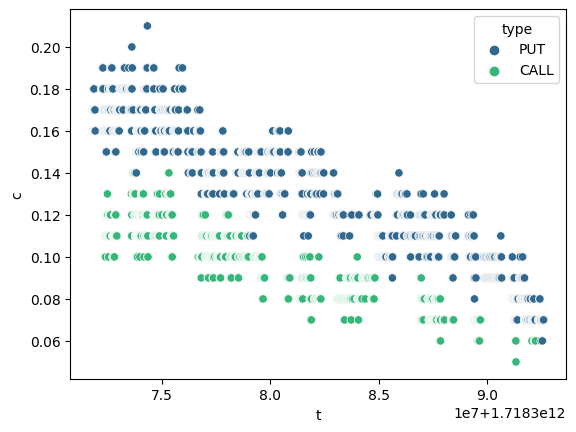

In [15]:
sns.scatterplot(x='t', y='c', data=df_delta, hue='type', palette='viridis')

<Axes: xlabel='diff', ylabel='Count'>

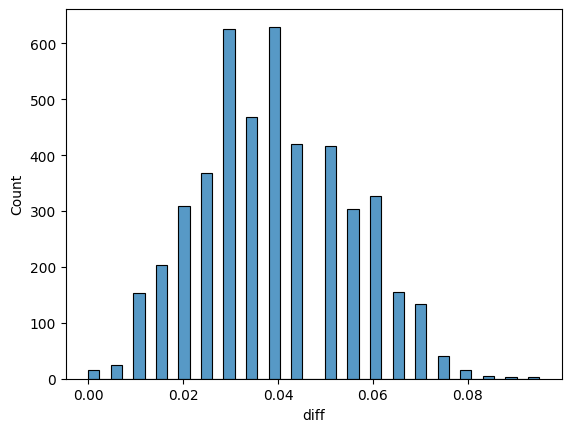

In [16]:
sns.histplot( x='diff', data=df_delta)

<Axes: xlabel='strike', ylabel='diff'>

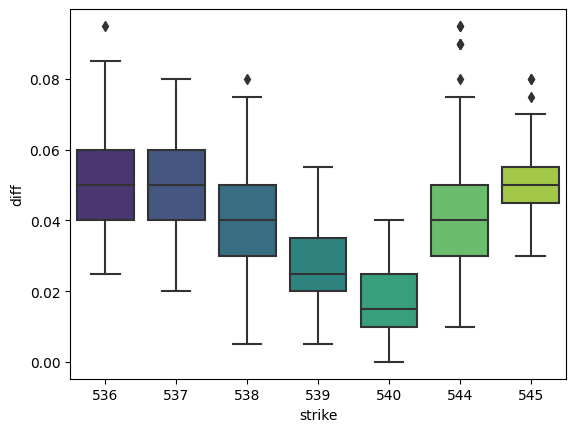

In [64]:
sns.boxplot(x='strike', y='diff', data=df_delta, palette='viridis')

In [ ]:
#sns.stripplot(x='strike', y='diff', data=df_delta, palette='viridis')

<Axes: xlabel='t', ylabel='diff'>

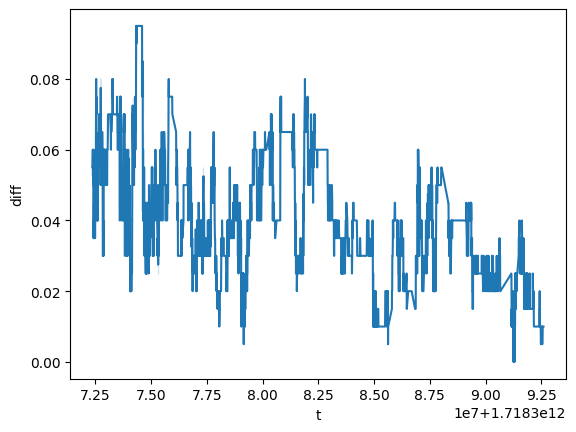

In [21]:
sns.lineplot(x='t', y='diff', data=df_delta, palette='viridis')

<Axes: xlabel='t', ylabel='avg_p'>

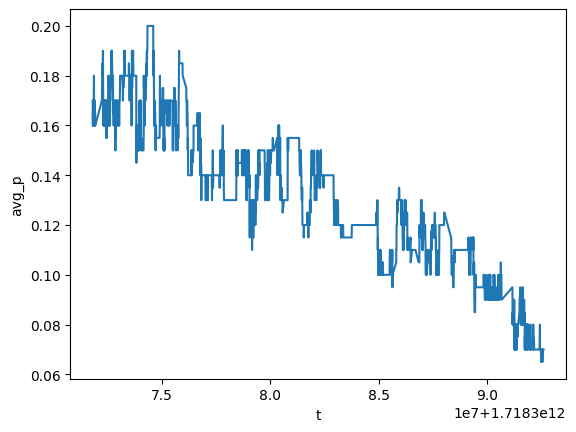

In [20]:
sns.lineplot(x='t', y='avg_p', data=df_delta, palette='viridis')

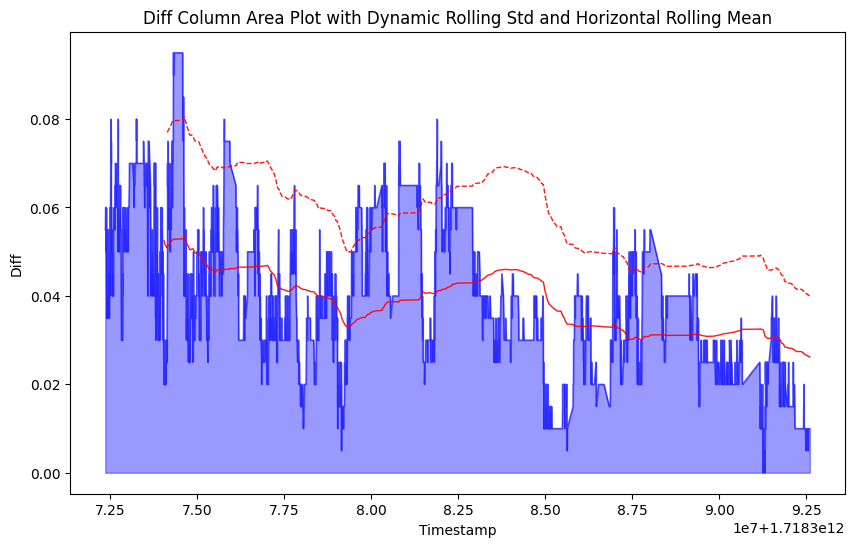

In [85]:
# Plotting the 'diff' column as an area plot with a dynamic line for rolling std and a horizontal line for rolling mean
plt.figure(figsize=(10, 6))
plt.fill_between(df_delta['t'], df_delta['diff'], color="blue", alpha=0.4)
plt.plot(df_delta['t'], df_delta['diff'], color="blue", alpha=0.6, linewidth=1)
plt.plot(df_delta['t'], df_delta['rolling_std'], color="red", alpha=0.9,linestyle='--', linewidth=1)
plt.plot(df_delta['t'], df_delta['rolling_mean'], color="red", alpha=0.9, linewidth=1)

plt.title('Diff Column Area Plot with Dynamic Rolling Std and Horizontal Rolling Mean')
plt.xlabel('Timestamp')
plt.ylabel('Diff')
plt.show()

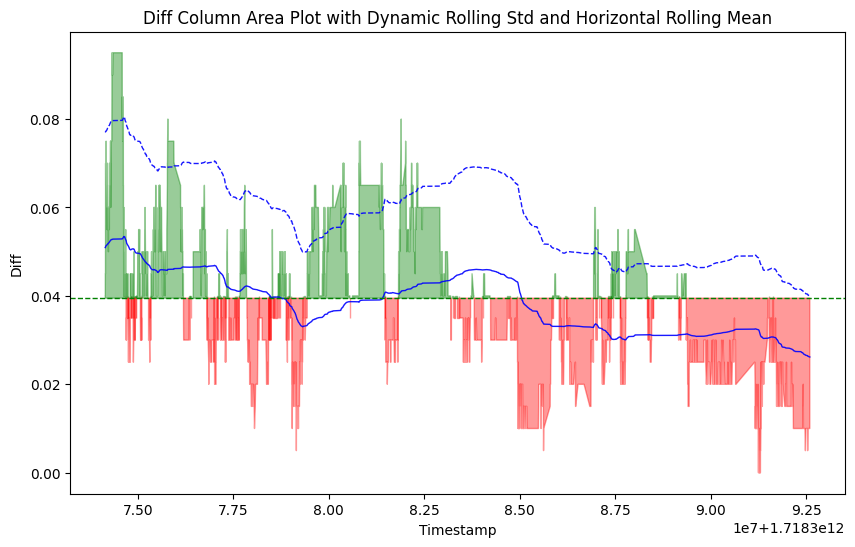

In [89]:
mean_of_rolling_mean = df_delta['rolling_mean'].mean()

# Ensure there are no NaN values in 'diff', 't', 'rolling_mean', and 'rolling_std'
df_delta = df_delta.dropna(subset=['diff', 't', 'rolling_mean', 'rolling_std'])

# Plotting the 'diff' column as an area plot with a dynamic line for rolling std and a horizontal line for rolling mean
plt.figure(figsize=(10, 6))
plt.fill_between(df_delta['t'], df_delta['diff'], mean_of_rolling_mean, where=(df_delta['diff'] >= mean_of_rolling_mean), color="green", alpha=0.4)
plt.fill_between(df_delta['t'], df_delta['diff'], mean_of_rolling_mean, where=(df_delta['diff'] < mean_of_rolling_mean), color="red", alpha=0.4)

plt.plot(df_delta['t'], df_delta['rolling_std'], color="blue", alpha=0.9, linestyle='--', linewidth=1)
plt.plot(df_delta['t'], df_delta['rolling_mean'], color="blue", alpha=0.9, linewidth=1)
plt.axhline(y=mean_of_rolling_mean, color='green', linestyle='--', linewidth=1)

plt.title('Diff Column Area Plot with Dynamic Rolling Std and Horizontal Rolling Mean')
plt.xlabel('Timestamp')
plt.ylabel('Diff')

# Display the plot
plt.show()

In [103]:
# Locate and list all rows where 'diff' value is above 'rolling_std'
rows_above_rolling_std = df_delta[df_delta['diff'] > df_delta['rolling_std']]

# Display the rows
rows_above_rolling_std['rolling_mean'] = round(rows_above_rolling_std['rolling_mean'],4)
rows_above_rolling_std['Beneficio'] = rows_above_rolling_std['c'] - rows_above_rolling_std['rolling_mean']
sum_beneficio = rows_above_rolling_std['Beneficio'].sum()
print('El Beneficio total es:',sum_beneficio )
rows_above_rolling_std[['id','date','underlying_price','time','ticker','c','rolling_mean','Beneficio']]

El Beneficio total es: 28.2436


,id,date,underlying_price,time,ticker,c,rolling_mean,Beneficio
1072,775,2024-06-14,540.430,16:12:02,O:SPY240614P00536000,0.21,0.0527,0.1573
1073,110349,2024-06-14,540.430,16:12:02,O:SPY240614C00544000,0.10,0.0527,0.0473
1074,110350,2024-06-14,540.430,16:12:06,O:SPY240614C00544000,0.11,0.0528,0.0572
1075,110351,2024-06-14,540.430,16:12:07,O:SPY240614C00544000,0.11,0.0528,0.0572
1076,110362,2024-06-14,540.430,16:12:23,O:SPY240614C00544000,0.11,0.0528,0.0572
1077,110366,2024-06-14,540.430,16:12:30,O:SPY240614C00544000,0.10,0.0528,0.0472
1078,928,2024-06-14,540.482,16:16:31,O:SPY240614P00536000,0.19,0.0529,0.1371
1079,929,2024-06-14,540.482,16:16:33,O:SPY240614P00536000,0.18,0.0529,0.1271
1080,930,2024-06-14,540.482,16:16:34,O:SPY240614P00536000,0.19,0.0529,0.1371
1081,931,2024-06-14,540.482,16:16:36,O:SPY240614P00536000,0.19,0.0529,0.1371
